# Import stuff

# Image Captioning Final Project

In this final project you will define and train an image-to-caption model, that can produce descriptions for real world images!

<img src="images/encoder_decoder.png" style="width:70%">

Model architecture: CNN encoder and RNN decoder. 
(https://research.googleblog.com/2014/11/a-picture-is-worth-thousand-coherent.html)

In [1]:
import sys
sys.path.append("..")
import grading
import download_utils

In [2]:
download_utils.link_all_keras_resources()

In [3]:
import tensorflow as tf
from tensorflow.contrib import keras
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
L = keras.layers
K = keras.backend
import tqdm
import utils
import time
import zipfile
import json
from collections import defaultdict
import re
import random
from random import choice
import grading_utils
import os

# Fill in your Coursera token and email
To successfully submit your answers to our grader, please fill in your Coursera submission token and email

In [44]:
grader = grading.Grader(assignment_key="NEDBg6CgEee8nQ6uE8a7OA", 
                        all_parts=["19Wpv", "uJh73", "yiJkt", "rbpnH", "E2OIL", "YJR7z"])

In [72]:
# token expires every 30 min
COURSERA_TOKEN = ''### YOUR TOKEN HERE
COURSERA_EMAIL = ''### YOUR EMAIL HERE

# Download data

Takes 10 hours and 20 GB. We've downloaded necessary files for you.

Relevant links (just in case):
- train images http://msvocds.blob.core.windows.net/coco2014/train2014.zip
- validation images http://msvocds.blob.core.windows.net/coco2014/val2014.zip
- captions for both train and validation http://msvocds.blob.core.windows.net/annotations-1-0-3/captions_train-val2014.zip

In [4]:
# we downloaded them for you, just link them here
download_utils.link_week_6_resources()

# Extract image features

We will use pre-trained InceptionV3 model for CNN encoder (https://research.googleblog.com/2016/03/train-your-own-image-classifier-with.html) and extract its last hidden layer as an embedding:

<img src="images/inceptionv3.png" style="width:70%">

In [5]:
IMG_SIZE = 299

In [6]:
# we take the last hidden layer of IncetionV3 as an image embedding
def get_cnn_encoder():
    K.set_learning_phase(False)
    model = keras.applications.InceptionV3(include_top=False) # returns a Keras Model instance.
    """
    Keras models: These models have a number of methods and attributes in common:
    Properties: 
        inputs: Retrieves the input tensor(s) of a layer.
            Returns: Input tensor or list of input tensors.
        output: Retrieves the output tensor(s) of a layer.
            Returns: Output tensor or list of output tensors.
    """
    preprocess_for_model = keras.applications.inception_v3.preprocess_input # Preprocesses a numpy array encoding a batch of images.

    model = keras.models.Model(model.inputs, keras.layers.GlobalAveragePooling2D()(model.output))
    """
    class tf.contrib.keras.models.Model: The Model class adds training & evaluation routines to a Container.
    """
    # 
    # 
    # Retrieves the input mask tensor(s) of a layer.

    """
    Class GlobalAveragePooling2D: Global average pooling operation for spatial data.
    Arguments:
        data_format: A string, one of channels_last (default) or channels_first. 
    
    Input shape: - If data_format='channels_last': 4D tensor with shape: (batch_size, rows, cols, channels) - If 
    data_format='channels_first': 4D tensor with shape: (batch_size, channels, rows, cols)
    
    Output shape: 2D tensor with shape: (batch_size, channels)    
    """
    
    return model, preprocess_for_model

Features extraction takes too much time on CPU:
- Takes 16 minutes on GPU.
- 25x slower (InceptionV3) on CPU and takes 7 hours.
- 10x slower (MobileNet) on CPU and takes 3 hours.

So we've done it for you with the following code:
```python
# load pre-trained model
K.clear_session()
encoder, preprocess_for_model = get_cnn_encoder()

# extract train features
train_img_embeds, train_img_fns = utils.apply_model(
    "train2014.zip", encoder, preprocess_for_model, input_shape=(IMG_SIZE, IMG_SIZE))
utils.save_pickle(train_img_embeds, "train_img_embeds.pickle")
utils.save_pickle(train_img_fns, "train_img_fns.pickle")

# extract validation features
val_img_embeds, val_img_fns = utils.apply_model(
    "val2014.zip", encoder, preprocess_for_model, input_shape=(IMG_SIZE, IMG_SIZE))
utils.save_pickle(val_img_embeds, "val_img_embeds.pickle")
utils.save_pickle(val_img_fns, "val_img_fns.pickle")

# sample images for learners
def sample_zip(fn_in, fn_out, rate=0.01, seed=42):
    np.random.seed(seed)
    with zipfile.ZipFile(fn_in) as fin, zipfile.ZipFile(fn_out, "w") as fout:
        sampled = filter(lambda _: np.random.rand() < rate, fin.filelist)
        for zInfo in sampled:
            fout.writestr(zInfo, fin.read(zInfo))
            
sample_zip("train2014.zip", "train2014_sample.zip")
sample_zip("val2014.zip", "val2014_sample.zip")
```

In [7]:
# load prepared embeddings
train_img_embeds = utils.read_pickle("train_img_embeds.pickle")
train_img_fns = utils.read_pickle("train_img_fns.pickle")
val_img_embeds = utils.read_pickle("val_img_embeds.pickle")
val_img_fns = utils.read_pickle("val_img_fns.pickle")
# check shapes
print(train_img_embeds.shape, len(train_img_fns))
print(val_img_embeds.shape, len(val_img_fns))

(82783, 2048) 82783
(40504, 2048) 40504


In [8]:
# check prepared samples of images
list(filter(lambda x: x.endswith("_sample.zip"), os.listdir(".")))

['val2014_sample.zip', 'train2014_sample.zip']

# Extract captions for images

In [9]:
# extract captions from zip
def get_captions_for_fns(fns, zip_fn, zip_json_path):
    zf = zipfile.ZipFile(zip_fn)
    j = json.loads(zf.read(zip_json_path).decode("utf8"))
    id_to_fn = {img["id"]: img["file_name"] for img in j["images"]}
    fn_to_caps = defaultdict(list)
    for cap in j['annotations']:
        fn_to_caps[id_to_fn[cap['image_id']]].append(cap['caption'])
    fn_to_caps = dict(fn_to_caps)
    return list(map(lambda x: fn_to_caps[x], fns))
    
train_captions = get_captions_for_fns(train_img_fns, "captions_train-val2014.zip", 
                                      "annotations/captions_train2014.json")

val_captions = get_captions_for_fns(val_img_fns, "captions_train-val2014.zip", 
                                      "annotations/captions_val2014.json")

# check shape
print(len(train_img_fns), len(train_captions))
print(len(val_img_fns), len(val_captions))

82783 82783
40504 40504


In [25]:
train_captions[:10]

[['A long dirt road going through a forest.',
  'A SCENE OF WATER AND A PATH WAY',
  'A sandy path surrounded by trees leads to a beach.',
  'Ocean view through a dirt road surrounded by a forested area. ',
  'dirt path leading beneath barren trees to open plains'],
 ['A group of zebra standing next to each other.',
  'This is an image of of zebras drinking',
  'ZEBRAS AND BIRDS SHARING THE SAME WATERING HOLE',
  'Zebras that are bent over and drinking water together.',
  'a number of zebras drinking water near one another'],
 ['A tabby cat sitting in front of a car.',
  'A brown and black cat sitting on driveway next to a white car.',
  'A sleepy looking cat sitting in front of a white car.',
  'A cat sits in front of a parked car.',
  'A cat sitting in front of a parked white car.  '],
 ['A woman walks down an empty street next to a large street clock.',
  'A clock is on top of the pole on the sidewalk',
  'A city street with a clock on the sidewalk.',
  'A clock is mounted to a pole

In [24]:
train_img_fns[:10]

['COCO_train2014_000000270070.jpg',
 'COCO_train2014_000000101772.jpg',
 'COCO_train2014_000000359320.jpg',
 'COCO_train2014_000000486482.jpg',
 'COCO_train2014_000000116155.jpg',
 'COCO_train2014_000000082143.jpg',
 'COCO_train2014_000000242307.jpg',
 'COCO_train2014_000000510484.jpg',
 'COCO_train2014_000000339597.jpg',
 'COCO_train2014_000000366396.jpg']

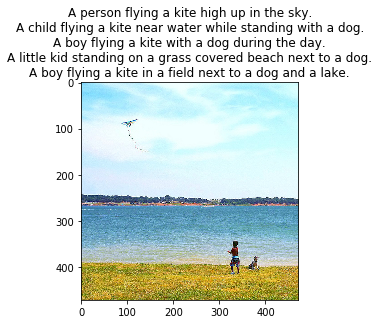

In [10]:
# look at training example (each has 5 captions)
def show_trainig_example(train_img_fns, train_captions, example_idx=0):
    """
    You can change example_idx and see different images
    """
    zf = zipfile.ZipFile("train2014_sample.zip")
    captions_by_file = dict(zip(train_img_fns, train_captions))
    all_files = set(train_img_fns)
    found_files = list(filter(lambda x: x.filename.rsplit("/")[-1] in all_files, zf.filelist))
    example = found_files[example_idx]
    img = utils.decode_image_from_buf(zf.read(example))
    plt.imshow(utils.image_center_crop(img))
    plt.title("\n".join(captions_by_file[example.filename.rsplit("/")[-1]]))
    plt.show()
    
show_trainig_example(train_img_fns, train_captions, example_idx=0)

# Prepare captions for training

In [11]:
# preview captions data
train_captions[:2]

[['A long dirt road going through a forest.',
  'A SCENE OF WATER AND A PATH WAY',
  'A sandy path surrounded by trees leads to a beach.',
  'Ocean view through a dirt road surrounded by a forested area. ',
  'dirt path leading beneath barren trees to open plains'],
 ['A group of zebra standing next to each other.',
  'This is an image of of zebras drinking',
  'ZEBRAS AND BIRDS SHARING THE SAME WATERING HOLE',
  'Zebras that are bent over and drinking water together.',
  'a number of zebras drinking water near one another']]

---

In [11]:
# special tokens
PAD = "#PAD#"
UNK = "#UNK#"
START = "#START#"
END = "#END#"

# split sentence into tokens (split into lowercased words)
def split_sentence(sentence):
    return list(filter(lambda x: len(x) > 0, re.split('\W+', sentence.lower())))

In [13]:
flattened = [sentence for caption in train_captions for sentence in caption]
flattened[:10]

['A long dirt road going through a forest.',
 'A SCENE OF WATER AND A PATH WAY',
 'A sandy path surrounded by trees leads to a beach.',
 'Ocean view through a dirt road surrounded by a forested area. ',
 'dirt path leading beneath barren trees to open plains',
 'A group of zebra standing next to each other.',
 'This is an image of of zebras drinking',
 'ZEBRAS AND BIRDS SHARING THE SAME WATERING HOLE',
 'Zebras that are bent over and drinking water together.',
 'a number of zebras drinking water near one another']

In [38]:
' '.join(flattened)

'A long dirt road going through a forest. A SCENE OF WATER AND A PATH WAY A sandy path surrounded by trees leads to a beach. Ocean view through a dirt road surrounded by a forested area.  dirt path leading beneath barren trees to open plains A group of zebra standing next to each other. This is an image of of zebras drinking ZEBRAS AND BIRDS SHARING THE SAME WATERING HOLE Zebras that are bent over and drinking water together. a number of zebras drinking water near one another A tabby cat sitting in front of a car. A brown and black cat sitting on driveway next to a white car. A sleepy looking cat sitting in front of a white car. A cat sits in front of a parked car. A cat sitting in front of a parked white car.   A woman walks down an empty street next to a large street clock. A clock is on top of the pole on the sidewalk A city street with a clock on the sidewalk. A clock is mounted to a pole on a sidewalk. there is a tall black clock in the middle of the street A crowd of people on a 

In [39]:
flattened = split_sentence(' '.join(flattened))
flattened[:10]

['a', 'long', 'dirt', 'road', 'going', 'through', 'a', 'forest', 'a', 'scene']

In [40]:
from collections import Counter
Counter(flattened)

Counter({'disposal': 5,
         'monaco': 1,
         'tedd': 1,
         'braking': 2,
         'removing': 43,
         'stairwell': 19,
         'bluberries': 1,
         'exchanging': 16,
         'camel': 40,
         'vechicle': 1,
         'serface': 1,
         'sword': 45,
         'powerful': 8,
         'wsith': 1,
         'taming': 2,
         'frisbee': 5570,
         'valances': 1,
         'dunk': 5,
         'foremost': 1,
         'iving': 1,
         'safely': 7,
         'puckish': 1,
         'recovers': 2,
         'remoter': 1,
         'merley': 1,
         'sweetcorn': 1,
         'sledders': 1,
         'kitchenware': 4,
         'appears': 357,
         'examined': 8,
         'black': 13497,
         'magnifier': 1,
         'poultry': 4,
         'lurching': 1,
         'cood': 1,
         'prominent': 20,
         'cones': 257,
         'pisture': 1,
         'spade': 1,
         'cages': 47,
         'collected': 8,
         'baking': 149,
         'thre

In [43]:
counter = Counter(flattened)
type(counter)

collections.Counter

In [46]:
vocab = [taken for taken, count in counter.items() if count >= 5]
vocab += [PAD, UNK, START, END]
vocab

['disposal',
 'removing',
 'stairwell',
 'exchanging',
 'camel',
 'sword',
 'powerful',
 'controls',
 'frisbee',
 'dunk',
 'safely',
 'appears',
 'examined',
 'black',
 'prominent',
 'cones',
 'basket',
 'cages',
 'collected',
 'baking',
 'thre',
 'appealing',
 'extension',
 'mount',
 'squeezed',
 'smoggy',
 'dinette',
 'kangaroo',
 'elf',
 'brush',
 'blades',
 'tapping',
 'selections',
 'cover',
 'inter',
 'furnishings',
 'fit',
 'docked',
 'trekking',
 'plums',
 'europe',
 'bead',
 'developed',
 'review',
 'why',
 'cowboy',
 'arrival',
 'old',
 'foodstuffs',
 'directly',
 'visiting',
 'nurse',
 'fatigues',
 'version',
 'skirt',
 'preserve',
 'storing',
 'added',
 'antelope',
 'creatively',
 'dishes',
 'boulevard',
 'knee',
 'heard',
 'servicing',
 'leashed',
 'characters',
 'burgundy',
 'boxcar',
 'hops',
 'goods',
 'plants',
 'recording',
 'humongous',
 'lifted',
 'listen',
 'pizzas',
 'curtains',
 'preparation',
 'tummy',
 'attractive',
 'geese',
 'feild',
 'lazing',
 'herded',
 'n

In [47]:
{token: index for index, token in enumerate(sorted(vocab))}

{'aboard': 60,
 'die': 2265,
 'disposal': 2338,
 'attractions': 436,
 'passing': 5417,
 'exits': 2748,
 'forming': 3120,
 'removing': 6234,
 'notice': 5063,
 'stairwell': 7285,
 'daybed': 2125,
 'beers': 681,
 'motorcycle': 4861,
 'exchanging': 2731,
 'drawn': 2443,
 'camel': 1170,
 'barge': 577,
 'females': 2871,
 'haired': 3532,
 'sword': 7631,
 'shakers': 6695,
 'powerful': 5858,
 'perhaps': 5558,
 'reads': 6145,
 'emptying': 2631,
 'calling': 1160,
 'oval': 5251,
 'smartphone': 7012,
 'frisbee': 3163,
 'glare': 3312,
 'dunk': 2517,
 'tool': 7944,
 'workstation': 8686,
 'plow': 5735,
 'baked': 517,
 'active': 85,
 'signing': 6845,
 'signpost': 6846,
 'antelope': 272,
 'avocado': 462,
 'panini': 5347,
 'spinach': 7192,
 'tokyo': 7927,
 'expression': 2765,
 'others': 5223,
 'watercraft': 8487,
 'guiding': 3507,
 'beams': 652,
 'appears': 296,
 'citrus': 1500,
 'examined': 2723,
 'black': 777,
 'underwater': 8203,
 'combed': 1661,
 'hydrogen': 3844,
 'diffrent': 2272,
 'cds': 1311,
 'w

---

In [12]:
# special tokens
PAD = "#PAD#"
UNK = "#UNK#"
START = "#START#"
END = "#END#"

# split sentence into tokens (split into lowercased words)
def split_sentence(sentence):
    return list(filter(lambda x: len(x) > 0, re.split('\W+', sentence.lower())))

from collections import Counter

def generate_vocabulary(train_captions):
    """
    Return {token: index} for all train tokens (words) that occur 5 times or more, 
        `index` should be from 0 to N, where N is a number of unique tokens in the resulting dictionary.
    Use `split_sentence` function to split sentence into tokens.
    Also, add PAD (for batch padding), UNK (unknown, out of vocabulary), 
        START (start of sentence) and END (end of sentence) tokens into the vocabulary.
    """
    flattened = [sentence for caption in train_captions for sentence in caption]
    flattened = split_sentence(' '.join(flattened))
    counter = Counter(flattened)
    vocab = [token for token, count in counter.items() if count >= 5]
    vocab += [PAD, UNK, START, END] ### YOUR CODE HERE ###
    return {token: index for index, token in enumerate(sorted(vocab))}
    
def caption_tokens_to_indices(captions, vocab):
    """
    `captions` argument is an array of arrays:
    [
        [
            "image1 caption1",
            "image1 caption2",
            ...
        ],
        [
            "image2 caption1",
            "image2 caption2",
            ...
        ],
        ...
    ]
    Use `split_sentence` function to split sentence into tokens.
    Replace all tokens with vocabulary indices, use UNK for unknown words (out of vocabulary).
    Add START and END tokens to start and end of each sentence respectively.
    For the example above you should produce the following:
    [
        [
            [vocab[START], vocab["image1"], vocab["caption1"], vocab[END]],
            [vocab[START], vocab["image1"], vocab["caption2"], vocab[END]],
            ...
        ],
        ...
    ]
    """
    res = \
    [
        [
            [vocab[START]] + [vocab[token] if token in vocab else vocab[UNK] for token in split_sentence(sentence)] + [vocab[END]]
            for sentence in caption
        ] for caption in captions
    ] ### YOUR CODE HERE ###
    return res

In [13]:
# prepare vocabulary
vocab = generate_vocabulary(train_captions)
vocab_inverse = {idx: w for w, idx in vocab.items()}
print(len(vocab))

8769


In [14]:
# replace tokens with indices
train_captions_indexed = caption_tokens_to_indices(train_captions, vocab)
val_captions_indexed = caption_tokens_to_indices(val_captions, vocab)

Captions have different length, but we need to batch them, that's why we will add PAD tokens so that all sentences have an euqal length. 

We will crunch LSTM through all the tokens, but we will ignore padding tokens during loss calculation.

In [15]:
# we will use this during training
def batch_captions_to_matrix(batch_captions, pad_idx, max_len=None):
    """
    `batch_captions` is an array of arrays:
    [
        [vocab[START], ..., vocab[END]],
        [vocab[START], ..., vocab[END]],
        ...
    ]
    Put vocabulary indexed captions into np.array of shape (len(batch_captions), columns),
        where "columns" is max(map(len, batch_captions)) when max_len is None
        and "columns" = min(max_len, max(map(len, batch_captions))) otherwise.
    Add padding with pad_idx where necessary.
    Input example: [[1, 2, 3], [4, 5]]
    Output example: np.array([[1, 2, 3], [4, 5, pad_idx]]) if max_len=None
    Output example: np.array([[1, 2], [4, 5]]) if max_len=2
    Output example: np.array([[1, 2, 3], [4, 5, pad_idx]]) if max_len=100
    Try to use numpy, we need this function to be fast!
    """
    if not max_len:
        max_len = max(map(len, batch_captions))
    else:
        max_len = min(max_len, max(map(len, batch_captions)))
        
    matrix = [caption[:max_len] + 
             [pad_idx]*(max_len - len(caption)) for caption in batch_captions] ###YOUR CODE HERE###
    return np.array(matrix)

---

In [41]:
train_captions_indexed[:10]

[[[2, 54, 4462, 2305, 6328, 3354, 7848, 54, 3107, 0],
  [2, 54, 6540, 5127, 8486, 249, 54, 5437, 8507, 0],
  [2, 54, 6502, 5437, 7581, 1124, 8052, 4287, 7905, 54, 639, 0],
  [2, 5120, 8367, 7848, 54, 2305, 6328, 7581, 1124, 54, 3108, 331, 0],
  [2, 2305, 5437, 4286, 710, 587, 8052, 7905, 5174, 5684, 0]],
 [[2, 54, 3484, 5127, 8755, 7296, 5025, 7905, 2540, 5222, 0],
  [2, 7835, 3998, 242, 3877, 5127, 5127, 8756, 2468, 0],
  [2, 8756, 249, 764, 6709, 7804, 6484, 8492, 3738, 0],
  [2, 8756, 7800, 330, 711, 5254, 249, 2468, 8486, 7919, 0],
  [2, 54, 5072, 5127, 8756, 2468, 8486, 4975, 5159, 269, 0]],
 [[2, 54, 7643, 1288, 6888, 3885, 3175, 5127, 54, 1227, 0],
  [2,
   54,
   1002,
   249,
   777,
   1288,
   6888,
   5155,
   2476,
   5025,
   7905,
   54,
   8568,
   1227,
   0],
  [2, 54, 6969, 4470, 1288, 6888, 3885, 3175, 5127, 54, 8568, 1227, 0],
  [2, 54, 1288, 6885, 3885, 3175, 5127, 54, 5387, 1227, 0],
  [2, 54, 1288, 6888, 3885, 3175, 5127, 54, 5387, 8568, 1227, 0]],
 [[2,
   54,


In [14]:
train_captions_indexed[0]

[[2, 54, 4462, 2305, 6328, 3354, 7848, 54, 3107, 0],
 [2, 54, 6540, 5127, 8486, 249, 54, 5437, 8507, 0],
 [2, 54, 6502, 5437, 7581, 1124, 8052, 4287, 7905, 54, 639, 0],
 [2, 5120, 8367, 7848, 54, 2305, 6328, 7581, 1124, 54, 3108, 331, 0],
 [2, 2305, 5437, 4286, 710, 587, 8052, 7905, 5174, 5684, 0]]

In [15]:
max(train_captions_indexed[0], key=lambda x:len(x))

[2, 5120, 8367, 7848, 54, 2305, 6328, 7581, 1124, 54, 3108, 331, 0]

In [17]:
list(map(len, train_captions_indexed[0]))

[10, 10, 12, 13, 11]

In [18]:
max(map(len, train_captions_indexed[0]))

13

In [19]:
len(max(train_captions_indexed[0], key=lambda x:len(x)))

13

In [22]:
[train_captions_indexed[0][0]]

[[2, 54, 4462, 2305, 6328, 3354, 7848, 54, 3107, 0]]

In [24]:
pad_idx = 1

In [28]:
len(train_captions_indexed[0][0])

10

In [27]:
13 - len(train_captions_indexed[0][0])

3

In [30]:
train_captions_indexed[0][0] + [pad_idx]*(13 - len(train_captions_indexed[0][0]))

[2, 54, 4462, 2305, 6328, 3354, 7848, 54, 3107, 0, 1, 1, 1]

In [34]:
max_len = max(map(len, train_captions_indexed[0]))
[caption + [pad_idx]*(max_len - len(caption)) for caption in train_captions_indexed[0]]

[[2, 54, 4462, 2305, 6328, 3354, 7848, 54, 3107, 0, 1, 1, 1],
 [2, 54, 6540, 5127, 8486, 249, 54, 5437, 8507, 0, 1, 1, 1],
 [2, 54, 6502, 5437, 7581, 1124, 8052, 4287, 7905, 54, 639, 0, 1],
 [2, 5120, 8367, 7848, 54, 2305, 6328, 7581, 1124, 54, 3108, 331, 0],
 [2, 2305, 5437, 4286, 710, 587, 8052, 7905, 5174, 5684, 0, 1, 1]]

In [36]:
max_len = 10
[caption[:max_len] + [pad_idx]*(max_len - len(caption)) for caption in train_captions_indexed[0]]

[[2, 54, 4462, 2305, 6328, 3354, 7848, 54, 3107, 0],
 [2, 54, 6540, 5127, 8486, 249, 54, 5437, 8507, 0],
 [2, 54, 6502, 5437, 7581, 1124, 8052, 4287, 7905, 54],
 [2, 5120, 8367, 7848, 54, 2305, 6328, 7581, 1124, 54],
 [2, 2305, 5437, 4286, 710, 587, 8052, 7905, 5174, 5684]]

In [49]:
np.array([caption[:max_len] + [pad_idx]*(max_len - len(caption)) for caption in train_captions_indexed[0]])

array([[   2,   54, 4462, 2305, 6328, 3354, 7848,   54, 3107,    0],
       [   2,   54, 6540, 5127, 8486,  249,   54, 5437, 8507,    0],
       [   2,   54, 6502, 5437, 7581, 1124, 8052, 4287, 7905,   54],
       [   2, 5120, 8367, 7848,   54, 2305, 6328, 7581, 1124,   54],
       [   2, 2305, 5437, 4286,  710,  587, 8052, 7905, 5174, 5684]])

In [37]:
vocab['#PAD#']

1

In [51]:
batch_captions_to_matrix([[1, 2, 3], [4, 5]], 1)

array([[1, 2, 3],
       [4, 5, 1]])

In [52]:
batch_captions_to_matrix([[1, 2, 3], [4, 5]], 1, 10)

array([[1, 2, 3],
       [4, 5, 1]])

In [53]:
batch_captions_to_matrix([[1, 2, 3], [4, 5]], -1, max_len=2).ravel().tolist()

[1, 2, 4, 5]

---

In [18]:
## GRADED PART, DO NOT CHANGE!
# Vocabulary creation
grader.set_answer("19Wpv", grading_utils.test_vocab(vocab, PAD, UNK, START, END))
# Captions indexing
grader.set_answer("uJh73", grading_utils.test_captions_indexing(train_captions_indexed, vocab, UNK))
# Captions batching
grader.set_answer("yiJkt", grading_utils.test_captions_batching(batch_captions_to_matrix))

NameError: name 'grader' is not defined

In [55]:
# you can make submission with answers so far to check yourself at this stage
grader.submit(COURSERA_EMAIL, COURSERA_TOKEN)

Submitted to Coursera platform. See results on assignment page!


In [56]:
# make sure you use correct argument in caption_tokens_to_indices
assert len(caption_tokens_to_indices(train_captions[:10], vocab)) == 10
assert len(caption_tokens_to_indices(train_captions[:5], vocab)) == 5

# Training

## Define architecture

Since our problem is to generate image captions, RNN text generator should be conditioned on image. The idea is to use image features as an initial state for RNN instead of zeros. 

Remember that you should transform image feature vector to RNN hidden state size by fully-connected layer and then pass it to RNN.

During training we will feed ground truth tokens into the lstm to get predictions of next tokens. 

Notice that we don't need to feed last token (END) as input (http://cs.stanford.edu/people/karpathy/):

<img src="images/encoder_decoder_explained.png" style="width:50%">

In [16]:
IMG_EMBED_SIZE = train_img_embeds.shape[1]
IMG_EMBED_BOTTLENECK = 120
WORD_EMBED_SIZE = 100
LSTM_UNITS = 300
LOGIT_BOTTLENECK = 120
pad_idx = vocab[PAD]

In [17]:
# remember to reset your graph if you want to start building it from scratch!
tf.reset_default_graph()
tf.set_random_seed(42)
s = tf.InteractiveSession()

Here we define decoder graph.

We use Keras layers where possible because we can use them in functional style with weights reuse like this:
```python
dense_layer = L.Dense(42, input_shape=(None, 100) activation='relu')
a = tf.placeholder('float32', [None, 100])
b = tf.placeholder('float32', [None, 100])
dense_layer(a)  # that's how we applied dense layer!
dense_layer(b)  # and again
```

Here's a figure to help you with flattening in decoder:
<img src="images/flatten_help.jpg" style="width:80%">

In [18]:
class decoder:
    # [batch_size, IMG_EMBED_SIZE] of CNN image features
    img_embeds = tf.placeholder('float32', [None, IMG_EMBED_SIZE])
    # [batch_size, time steps] of word ids
    sentences = tf.placeholder('int32', [None, None])
    
    # we use bottleneck here to reduce the number of parameters
    # image embedding -> bottleneck
    img_embed_to_bottleneck = L.Dense(IMG_EMBED_BOTTLENECK, 
                                      input_shape=(None, IMG_EMBED_SIZE), 
                                      activation='elu')
    # image embedding bottleneck -> lstm initial state
    img_embed_bottleneck_to_h0 = L.Dense(LSTM_UNITS,
                                         input_shape=(None, IMG_EMBED_BOTTLENECK),
                                         activation='elu')
    # word -> embedding
    word_embed = L.Embedding(len(vocab), WORD_EMBED_SIZE)
    # lstm cell (from tensorflow)
    lstm = tf.nn.rnn_cell.LSTMCell(LSTM_UNITS)
    
    # we use bottleneck here to reduce model complexity
    # lstm output -> logits bottleneck
    token_logits_bottleneck = L.Dense(LOGIT_BOTTLENECK, 
                                      input_shape=(None, LSTM_UNITS),
                                      activation="elu")
    # logits bottleneck -> logits for next token prediction
    token_logits = L.Dense(len(vocab),
                           input_shape=(None, LOGIT_BOTTLENECK))
    
    # initial lstm cell state of shape (None, LSTM_UNITS),
    # we need to condition it on `img_embeds` placeholder.
    c0 = h0 = img_embed_bottleneck_to_h0(img_embed_to_bottleneck(img_embeds)) ### YOUR CODE HERE ###

    # embed all tokens but the last for lstm input,
    # remember that L.Embedding is callable,
    # use `sentences` placeholder as input.
    word_embeds = word_embed(sentences[: , : -1]) ### YOUR CODE HERE ###
    
    # during training we use ground truth tokens `word_embeds` as context for next token prediction.
    # that means that we know all the inputs for our lstm and can get 
    # all the hidden states with one tensorflow operation (tf.nn.dynamic_rnn).
    # `hidden_states` has a shape of [batch_size, time steps, LSTM_UNITS].
    hidden_states, _ = tf.nn.dynamic_rnn(lstm, word_embeds,
                                         initial_state=tf.nn.rnn_cell.LSTMStateTuple(c0, h0))

    # now we need to calculate token logits for all the hidden states
    
    # first, we reshape `hidden_states` to [-1, LSTM_UNITS]
    flat_hidden_states = tf.reshape(hidden_states, [-1, LSTM_UNITS]) ### YOUR CODE HERE ###

    # then, we calculate logits for next tokens using `token_logits_bottleneck` and `token_logits` layers
    flat_token_logits = token_logits(token_logits_bottleneck(flat_hidden_states)) ### YOUR CODE HERE ###
    
    # then, we flatten the ground truth token ids.
    # remember, that we predict next tokens for each time step,
    # use `sentences` placeholder.
    flat_ground_truth = tf.reshape(sentences[: , 1: ], [-1, ]) ### YOUR CODE HERE ###

    # we need to know where we have real tokens (not padding) in `flat_ground_truth`,
    # we don't want to propagate the loss for padded output tokens,
    # fill `flat_loss_mask` with 1.0 for real tokens (not pad_idx) and 0.0 otherwise.
    flat_loss_mask = tf.not_equal(flat_ground_truth, pad_idx) ### YOUR CODE HERE ###

    # compute cross-entropy between `flat_ground_truth` and `flat_token_logits` predicted by lstm
    xent = tf.nn.sparse_softmax_cross_entropy_with_logits(
        labels=flat_ground_truth, 
        logits=flat_token_logits
    )

    # compute average `xent` over tokens with nonzero `flat_loss_mask`.
    # we don't want to account misclassification of PAD tokens, because that doesn't make sense,
    # we have PAD tokens for batching purposes only!
    loss = tf.reduce_mean(tf.boolean_mask(xent, flat_loss_mask)) ### YOUR CODE HERE ###

In [19]:
# define optimizer operation to minimize the loss
optimizer = tf.train.AdamOptimizer(learning_rate=0.001)
train_step = optimizer.minimize(decoder.loss)

# will be used to save/load network weights.
# you need to reset your default graph and define it in the same way to be able to load the saved weights!
saver = tf.train.Saver()

# intialize all variables
s.run(tf.global_variables_initializer())

/usr/local/lib/python3.5/dist-packages/tensorflow/python/ops/gradients_impl.py:93: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


In [62]:
## GRADED PART, DO NOT CHANGE!
# Decoder shapes test
grader.set_answer("rbpnH", grading_utils.test_decoder_shapes(decoder, IMG_EMBED_SIZE, vocab, s))
# Decoder random loss test
grader.set_answer("E2OIL", grading_utils.test_random_decoder_loss(decoder, IMG_EMBED_SIZE, vocab, s))

In [63]:
# you can make submission with answers so far to check yourself at this stage
grader.submit(COURSERA_EMAIL, COURSERA_TOKEN)

Submitted to Coursera platform. See results on assignment page!


## Training loop
Evaluate train and validation metrics through training and log them. Ensure that loss decreases.

In [20]:
train_captions_indexed = np.array(train_captions_indexed)
val_captions_indexed = np.array(val_captions_indexed)

In [66]:
val_captions_indexed[: 5]

array([ [[2, 54, 6587, 6888, 5155, 7804, 5619, 8647, 7804, 4367, 3795, 691, 3709, 0], [2, 54, 761, 3998, 6888, 5155, 7804, 6081, 5025, 7905, 7804, 4211, 249, 54, 4367, 3795, 0], [2, 8568, 761, 6888, 3885, 3175, 5127, 54, 4371, 8647, 54, 6179, 6367, 0], [2, 54, 6587, 6271, 5155, 54, 1724, 8439, 8647, 7804, 5120, 249, 54, 4371, 3885, 7804, 485, 0], [2, 54, 6587, 6888, 5155, 54, 1326, 4316, 80, 3173, 54, 4371, 5812, 0]],
       [[2, 54, 8608, 8367, 5127, 54, 3237, 402, 54, 8686, 0], [2, 242, 2630, 5704, 3998, 5155, 7804, 1715, 2227, 4975, 54, 8608, 0], [2, 54, 2227, 5025, 7905, 54, 8608, 8647, 54, 4242, 249, 54, 4884, 0], [2, 54, 7645, 8647, 54, 4242, 6888, 5025, 7905, 242, 5174, 8608, 0], [2, 54, 4242, 249, 54, 5704, 5155, 54, 7645, 0]],
       [[2, 54, 7743, 656, 6885, 233, 54, 7354, 7639, 249, 54, 5072, 5127, 6173, 0], [2, 54, 1586, 6739, 8647, 54, 7354, 867, 249, 54, 7743, 656, 0], [2, 54, 8367, 5127, 54, 7743, 656, 6888, 3885, 54, 1348, 3885, 54, 5714, 6372, 0], [2, 7804, 7491, 7743,

In [21]:
# generate batch via random sampling of images and captions for them,
# we use `max_len` parameter to control the length of the captions (truncating long captions)
def generate_batch(images_embeddings, indexed_captions, batch_size, max_len=None):
    """
    `images_embeddings` is a np.array of shape [number of images, IMG_EMBED_SIZE].
    `indexed_captions` holds 5 vocabulary indexed captions for each image:
    [
        [
            [vocab[START], vocab["image1"], vocab["caption1"], vocab[END]],
            [vocab[START], vocab["image1"], vocab["caption2"], vocab[END]],
            ...
        ],
        ...
    ]
    Generate a random batch of size `batch_size`.
    Take random images and choose one random caption for each image.
    Remember to use `batch_captions_to_matrix` for padding and respect `max_len` parameter.
    Return feed dict {decoder.img_embeds: ..., decoder.sentences: ...}.
    """
    index_batch = np.random.choice(range(len(images_embeddings)), batch_size, replace = False)
    batch_image_embeddings = images_embeddings[index_batch] ### YOUR CODE HERE ###
    
    batch_captions = [caption[np.random.randint(5)] for caption in indexed_captions[index_batch]]
    batch_captions_matrix = batch_captions_to_matrix(batch_captions, pad_idx, max_len = max_len) ### YOUR CODE HERE ### 
    # batch_captions_to_matrix(batch_captions, pad_idx, max_len=None)
    
    return {decoder.img_embeds: batch_image_embeddings, 
            decoder.sentences: batch_captions_matrix}

In [22]:
batch_size = 64
n_epochs = 12
n_batches_per_epoch = 1000
n_validation_batches = 100  # how many batches are used for validation after each epoch

In [ ]:
# you can load trained weights here
# you can load "weights_{epoch}" and continue training
# uncomment the next line if you need to load weights
# saver.restore(s, os.path.abspath("weights"))

Look at the training and validation loss, they should be decreasing!

In [71]:
# actual training loop
MAX_LEN = 20  # truncate long captions to speed up training

# to make training reproducible
np.random.seed(42)
random.seed(42)

for epoch in range(n_epochs):
    
    train_loss = 0
    pbar = tqdm.tqdm_notebook(range(n_batches_per_epoch))
    counter = 0
    for _ in pbar:
        train_loss += s.run([decoder.loss, train_step], 
                            generate_batch(train_img_embeds, 
                                           train_captions_indexed, 
                                           batch_size, 
                                           MAX_LEN))[0]
        counter += 1
        pbar.set_description("Training loss: %f" % (train_loss / counter))
        
    train_loss /= n_batches_per_epoch
    
    val_loss = 0
    for _ in range(n_validation_batches):
        val_loss += s.run(decoder.loss, generate_batch(val_img_embeds,
                                                       val_captions_indexed, 
                                                       batch_size, 
                                                       MAX_LEN))
    val_loss /= n_validation_batches
    
    print('Epoch: {}, train loss: {}, val loss: {}'.format(epoch, train_loss, val_loss))

    # save weights after finishing epoch
    saver.save(s, os.path.abspath("weights_{}".format(epoch)))
    
print("Finished!")

HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))



Epoch: 0, train loss: 4.31184641957283, val loss: 3.6578121280670164


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 1, train loss: 3.3475479652881623, val loss: 3.1448382043838503


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 2, train loss: 3.0474711921215056, val loss: 2.9961944341659548


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 3, train loss: 2.897694983482361, val loss: 2.900957226753235


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 4, train loss: 2.810883505344391, val loss: 2.8393061995506286


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 5, train loss: 2.7466043293476106, val loss: 2.7789104056358336


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 6, train loss: 2.687409117460251, val loss: 2.7349607276916506


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 7, train loss: 2.643493921518326, val loss: 2.7121605849266053


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 8, train loss: 2.612583278179169, val loss: 2.6609566688537596


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 9, train loss: 2.576186597108841, val loss: 2.6560182547569275


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 10, train loss: 2.549352714061737, val loss: 2.6429098510742186


HBox(children=(IntProgress(value=0, max=1000), HTML(value='')))


Epoch: 11, train loss: 2.527698839902878, val loss: 2.6243097043037413
Finished!


In [ ]:
## GRADED PART, DO NOT CHANGE!
# Validation loss
grader.set_answer("YJR7z", grading_utils.test_validation_loss(
    decoder, s, generate_batch, val_img_embeds, val_captions_indexed))

In [ ]:
# you can make submission with answers so far to check yourself at this stage
grader.submit(COURSERA_EMAIL, COURSERA_TOKEN)

In [ ]:
# check that it's learnt something, outputs accuracy of next word prediction (should be around 0.5)
from sklearn.metrics import accuracy_score, log_loss

def decode_sentence(sentence_indices):
    return " ".join(list(map(vocab_inverse.get, sentence_indices)))

def check_after_training(n_examples):
    fd = generate_batch(train_img_embeds, train_captions_indexed, batch_size)
    logits = decoder.flat_token_logits.eval(fd)
    truth = decoder.flat_ground_truth.eval(fd)
    mask = decoder.flat_loss_mask.eval(fd).astype(bool)
    print("Loss:", decoder.loss.eval(fd))
    print("Accuracy:", accuracy_score(logits.argmax(axis=1)[mask], truth[mask]))
    for example_idx in range(n_examples):
        print("Example", example_idx)
        print("Predicted:", decode_sentence(logits.argmax(axis=1).reshape((batch_size, -1))[example_idx]))
        print("Truth:", decode_sentence(truth.reshape((batch_size, -1))[example_idx]))
        print("")

check_after_training(3)

In [ ]:
# save graph weights to file!
saver.save(s, os.path.abspath("weights"))

# Applying model

Here we construct a graph for our final model.

It will work as follows:
- take an image as an input and embed it
- condition lstm on that embedding
- predict the next token given a START input token
- use predicted token as an input at next time step
- iterate until you predict an END token

In [23]:
class final_model:
    # CNN encoder
    encoder, preprocess_for_model = get_cnn_encoder()
    saver.restore(s, os.path.abspath("weights"))  # keras applications corrupt our graph, so we restore trained weights
    
    # containers for current lstm state
    lstm_c = tf.Variable(tf.zeros([1, LSTM_UNITS]), name="cell")
    lstm_h = tf.Variable(tf.zeros([1, LSTM_UNITS]), name="hidden")

    # input images
    input_images = tf.placeholder('float32', [1, IMG_SIZE, IMG_SIZE, 3], name='images')

    # get image embeddings
    img_embeds = encoder(input_images)

    # initialize lstm state conditioned on image
    init_c = init_h = decoder.img_embed_bottleneck_to_h0(decoder.img_embed_to_bottleneck(img_embeds))
    init_lstm = tf.assign(lstm_c, init_c), tf.assign(lstm_h, init_h)
    
    # current word index
    current_word = tf.placeholder('int32', [1], name='current_input')

    # embedding for current word
    word_embed = decoder.word_embed(current_word)

    # apply lstm cell, get new lstm states
    new_c, new_h = decoder.lstm(word_embed, tf.nn.rnn_cell.LSTMStateTuple(lstm_c, lstm_h))[1]

    # compute logits for next token
    new_logits = decoder.token_logits(decoder.token_logits_bottleneck(new_h))
    # compute probabilities for next token
    new_probs = tf.nn.softmax(new_logits)

    # `one_step` outputs probabilities of next token and updates lstm hidden state
    one_step = new_probs, tf.assign(lstm_c, new_c), tf.assign(lstm_h, new_h)

INFO:tensorflow:Restoring parameters from /root/intro-to-dl/week6/weights


In [27]:
# look at how temperature works for probability distributions
# for high temperature we have more uniform distribution
_ = np.array([0.5, 0.4, 0.1])
for t in [0.01, 0.1, 1, 10, 100]:
    print(" ".join(map(str, _**(1/t) / np.sum(_**(1/t)))), "with temperature", t)

0.999999999796 2.03703597592e-10 1.26765059997e-70 with temperature 0.01
0.903037043325 0.0969628642039 9.24709932365e-08 with temperature 0.1
0.5 0.4 0.1 with temperature 1
0.353447726392 0.345648113606 0.300904160002 with temperature 10
0.335367280481 0.334619764349 0.33001295517 with temperature 100


In [24]:
# this is an actual prediction loop
def generate_caption(image, t=1, sample=False, max_len=20):
    """
    Generate caption for given image.
    if `sample` is True, we will sample next token from predicted probability distribution.
    `t` is a temperature during that sampling,
        higher `t` causes more uniform-like distribution = more chaos.
    """
    # condition lstm on the image
    s.run(final_model.init_lstm, 
          {final_model.input_images: [image]})
    
    # current caption
    # start with only START token
    caption = [vocab[START]]
    
    for _ in range(max_len):
        next_word_probs = s.run(final_model.one_step, 
                                {final_model.current_word: [caption[-1]]})[0]
        next_word_probs = next_word_probs.ravel()
        
        # apply temperature
        next_word_probs = next_word_probs**(1/t) / np.sum(next_word_probs**(1/t))

        if sample:
            next_word = np.random.choice(range(len(vocab)), p=next_word_probs)
        else:
            next_word = np.argmax(next_word_probs)

        caption.append(next_word)
        if next_word == vocab[END]:
            break
       
    return list(map(vocab_inverse.get, caption))

a baseball player swinging a bat at a baseball game


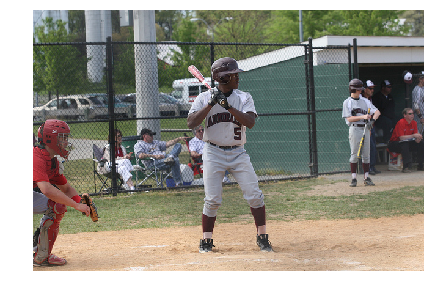

In [25]:
# look at validation prediction example
def apply_model_to_image_raw_bytes(raw):
    img = utils.decode_image_from_buf(raw)
    fig = plt.figure(figsize=(7, 7))
    plt.grid('off')
    plt.axis('off')
    plt.imshow(img)
    img = utils.crop_and_preprocess(img, (IMG_SIZE, IMG_SIZE), final_model.preprocess_for_model)
    print(' '.join(generate_caption(img)[1:-1]))
    plt.show()

def show_valid_example(val_img_fns, example_idx=0):
    zf = zipfile.ZipFile("val2014_sample.zip")
    all_files = set(val_img_fns)
    found_files = list(filter(lambda x: x.filename.rsplit("/")[-1] in all_files, zf.filelist))
    example = found_files[example_idx]
    apply_model_to_image_raw_bytes(zf.read(example))
    
show_valid_example(val_img_fns, example_idx=100)

a cat is sitting on a laptop computer


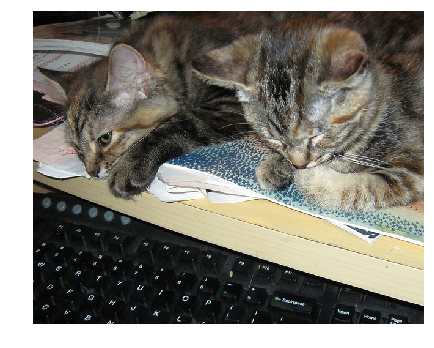

a traffic light suspended over a city street


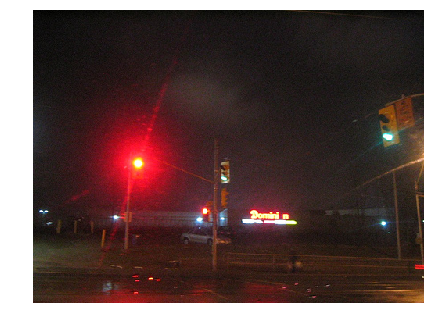

a man riding a wave on a surfboard


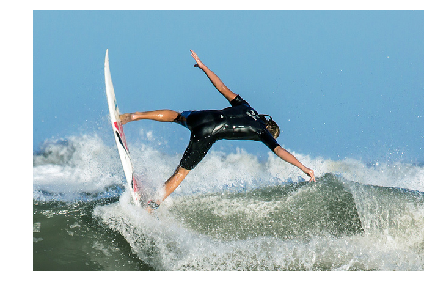

a man standing in a kitchen with a sink and a sink


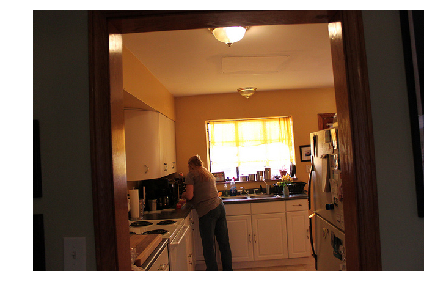

a man holding a cell phone in a room


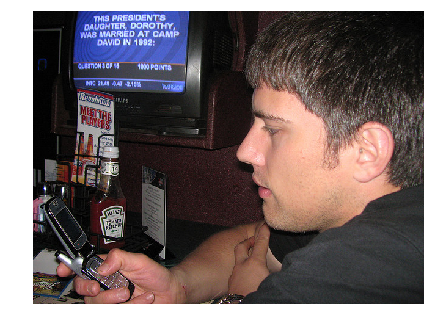

a elephant standing next to a tree in a field


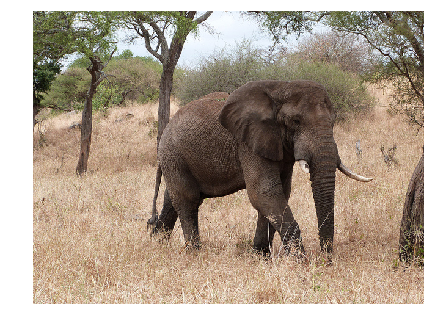

a pile of vegetables and vegetables on a table


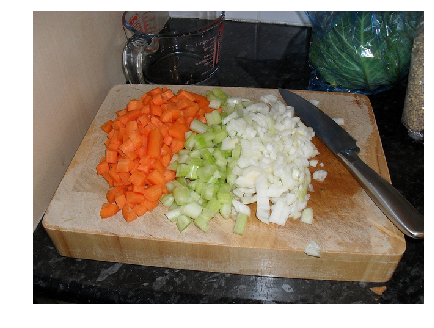

a man standing in front of a kitchen counter


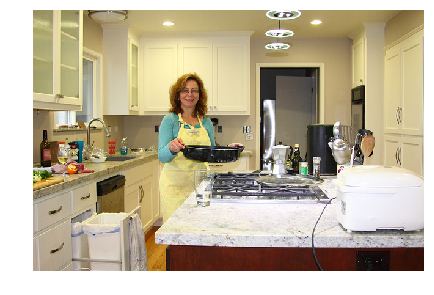

a man standing on a street corner with a stop sign


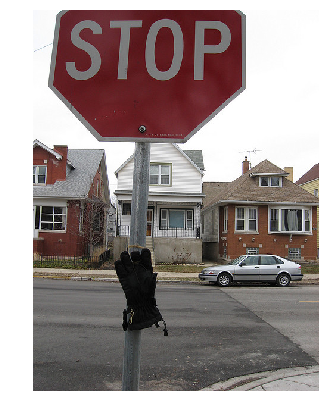

a man holding a cell phone while sitting on a table


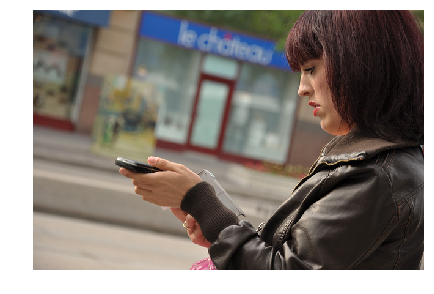

In [31]:
# sample more images from validation
for idx in np.random.choice(range(len(zipfile.ZipFile("val2014_sample.zip").filelist) - 1), 10):
    show_valid_example(val_img_fns, example_idx=idx)
    time.sleep(1)

You can download any image from the Internet and appply your model to it!

In [27]:
download_utils.download_file(
    "http://www.bijouxandbits.com/wp-content/uploads/2016/06/portal-cake-10.jpg",
    "portal-cake-10.jpg"
)

HBox(children=(IntProgress(value=0, max=273364), HTML(value='')))

a cake with a fork and sprinkles on it


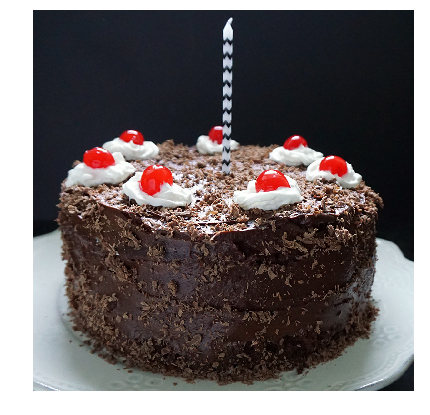

In [28]:
apply_model_to_image_raw_bytes(open("portal-cake-10.jpg", "rb").read())

Now it's time to find 10 examples where your model works good and 10 examples where it fails! 

You can use images from validation set as follows:
```python
show_valid_example(val_img_fns, example_idx=...)
```

You can use images from the Internet as follows:
```python
! wget ...
apply_model_to_image_raw_bytes(open("...", "rb").read())
```

If you use these functions, the output will be embedded into your notebook and will be visible during peer review!

When you're done, download your noteboook using "File" -> "Download as" -> "Notebook" and prepare that file for peer review!

## works good

a plane sitting on a tarmac with a plane on the tarmac


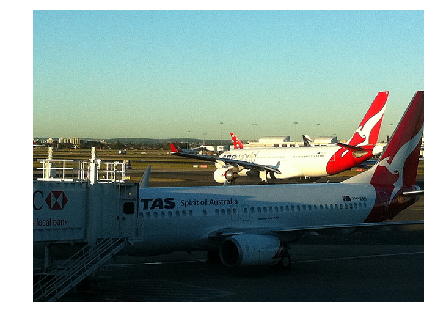

In [36]:
show_valid_example (val_img_fns, example_idx=4) ### YOUR EXAMPLES HERE ###

a large elephant standing next to a fence


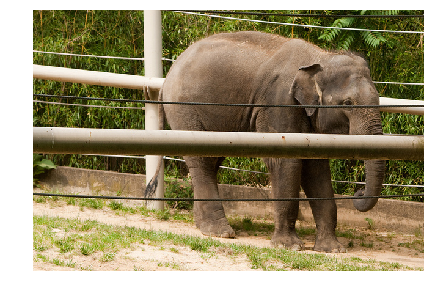

In [37]:
show_valid_example (val_img_fns, example_idx=5) ### YOUR EXAMPLES HERE ###

a bike parked on a sidewalk next to a building


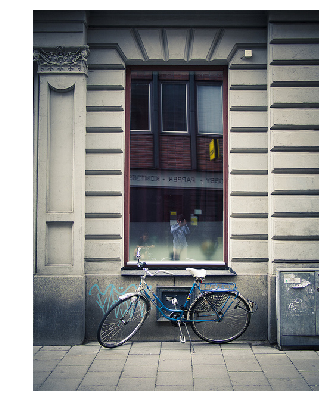

In [39]:
show_valid_example(val_img_fns, example_idx=7)

a street sign with a street sign and a street sign


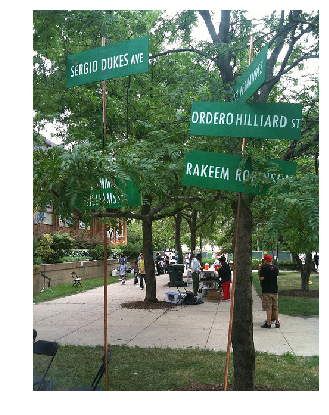

In [43]:
show_valid_example(val_img_fns, example_idx=10)

a table with a variety of vegetables and vegetables


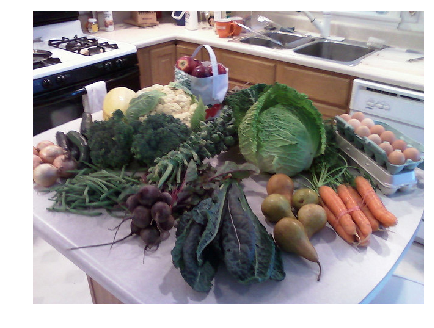

In [48]:
show_valid_example(val_img_fns, example_idx=14)

a laptop computer sitting on top of a table


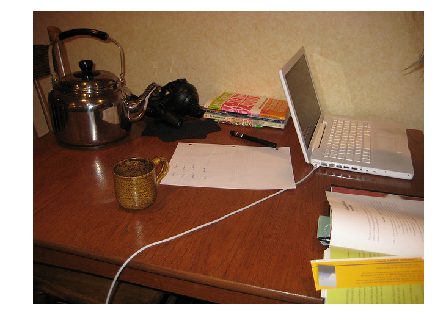

In [51]:
show_valid_example(val_img_fns, example_idx=17)

a man sitting at a table with a laptop computer


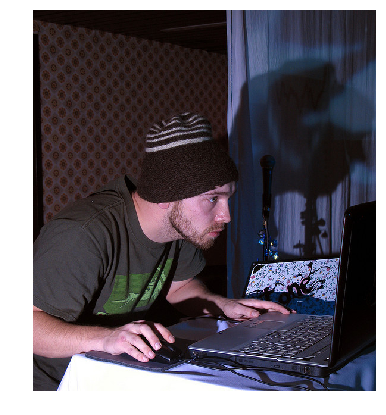

In [52]:
show_valid_example(val_img_fns, example_idx=18)

a person skiing down a snowy slope


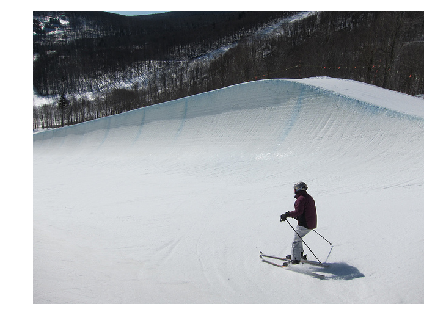

In [54]:
show_valid_example(val_img_fns, example_idx=20)

a man sitting at a table with a pizza and a pizza


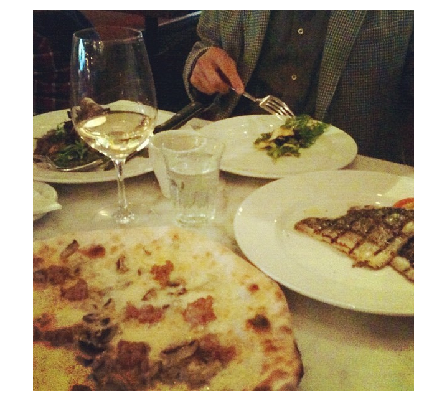

In [55]:
show_valid_example(val_img_fns, example_idx=21)

a table topped with plates of food and a bowl of soup


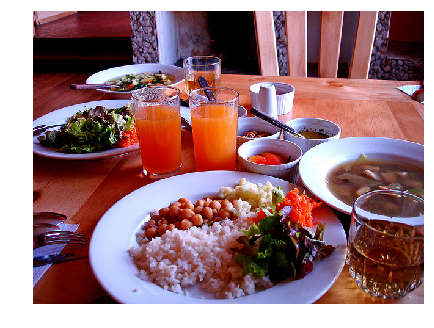

In [70]:
show_valid_example(val_img_fns, example_idx=34)

## Fails

a train is coming down the tracks near a building


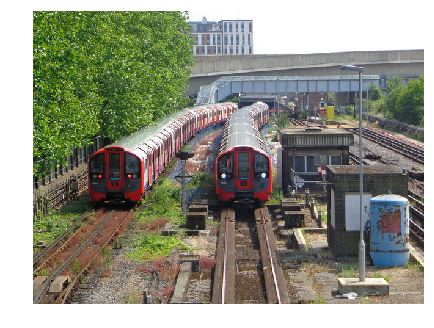

In [29]:
show_valid_example(val_img_fns, example_idx=0) ### YOUR EXAMPLES HERE ###

a living room with a couch and a fireplace


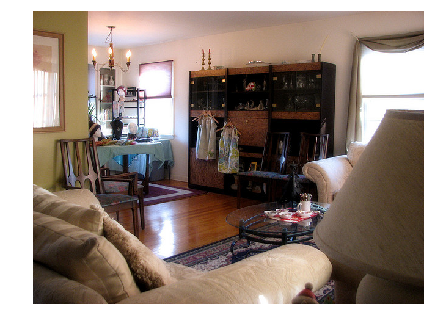

In [30]:
show_valid_example(val_img_fns, example_idx=1) ### YOUR EXAMPLES HERE ###

a table topped with a plate of food and a glass of wine


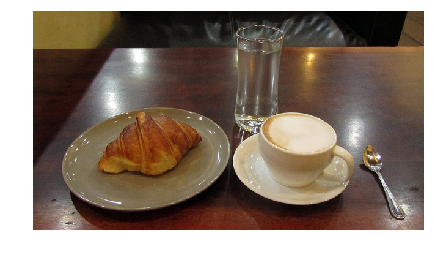

In [32]:
show_valid_example (val_img_fns, example_idx=2) ### YOUR EXAMPLES HERE ###

a elephant standing next to a tree in a field


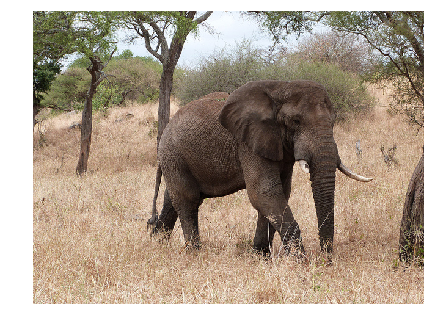

In [33]:
show_valid_example (val_img_fns, example_idx=3) ### YOUR EXAMPLES HERE ###

a laptop computer sitting on a desk next to a keyboard


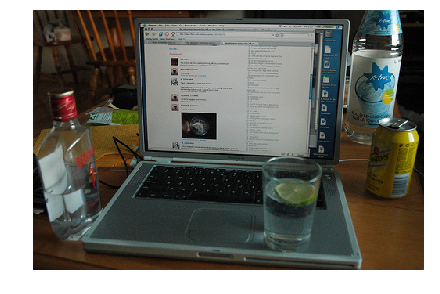

In [38]:
show_valid_example (val_img_fns, example_idx=6) ### YOUR EXAMPLES HERE ###

a kitchen with a lot of vegetables and a bowl of fruit


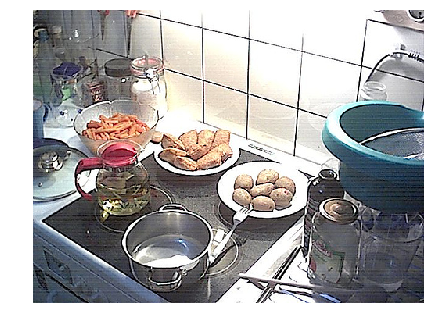

In [40]:
show_valid_example(val_img_fns, example_idx=8)

a keyboard sitting on a desk next to a keyboard


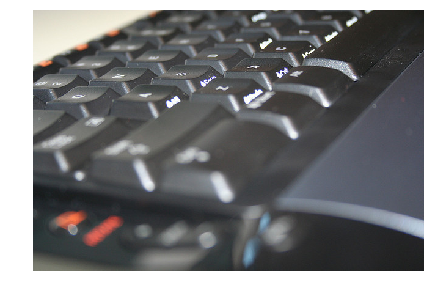

In [42]:
show_valid_example(val_img_fns, example_idx=9)

a group of people sitting on a bench with a dog


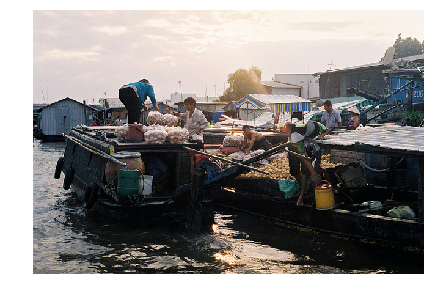

In [44]:
show_valid_example(val_img_fns, example_idx=11)

a cat sitting on a laptop computer on a desk


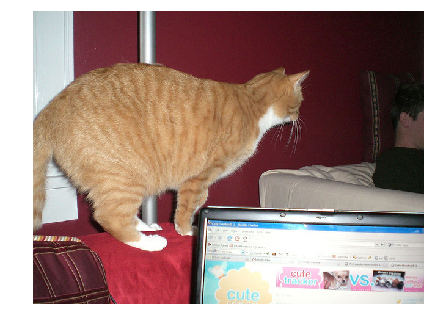

In [45]:
show_valid_example(val_img_fns, example_idx=12)

a room with a desk and a desk and a desk


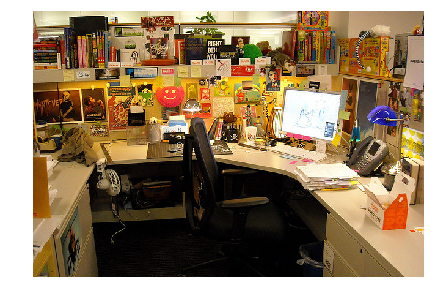

In [46]:
show_valid_example(val_img_fns, example_idx=13)

a man holding a cell phone while sitting on a table


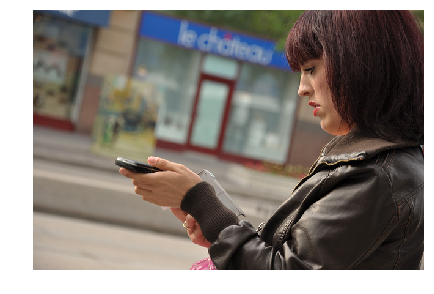

In [49]:
show_valid_example(val_img_fns, example_idx=15)

a white truck parked next to a building


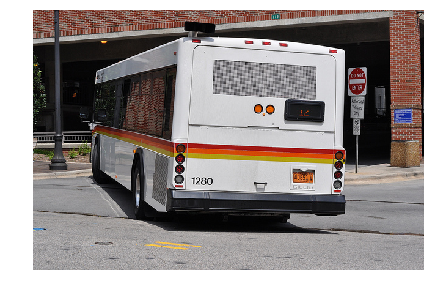

In [50]:
show_valid_example(val_img_fns, example_idx=16)

a man riding a wave on a surfboard


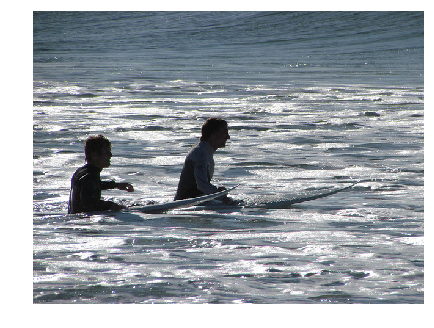

In [53]:
show_valid_example(val_img_fns, example_idx=19)

That's it! 

Congratulations, you've trained your image captioning model and now can produce captions for any picture from the  Internet!